### Problem 1 (10 Points)

Sketch graphically the problem 

$$
\begin{aligned}
\min_{x_1,x_2} & \quad f({\bf x})=(x_1+1)^2+(x_2-2)^2\\
{\text{subject to }} & \quad g_1 = x_1-2\leq 0,{\quad} g_3 = -x_1\leq 0,\\
& \quad g_2 = x_2-1\leq 0, {\quad} g_4 = -x_2\leq 0.
\end{aligned}
$$

Find the optimum graphically. Determine directions of feasible descent at the corner points of the feasible domain. Show the gradient directions of $f$ and $g_i$s at these points. Verify graphical results analytically using the KKT conditions.

### Problem 2 (10 Points)

Graph the problem 

$$
\begin{aligned}
\min_{x_1,x_2} & \quad  f=-x_1\\
{\text{subject to }} & \quad g_1=x_2-(1-x_1)^3\leq 0{\quad} {\rm and}{\quad} x_2\geq 0.
\end{aligned}
$$ 

Find the solution graphically. Then apply the optimality conditions. Can you find a solution based on the optimality conditions? Why? (From Kuhn and Tucker, 1951.)

### Problem 3 (30 Points)

Find a local solution to the problem 

$$
\begin{aligned}
\max_{x_1,x_2,x_3} & \quad  f=x_1x_2+x_2x_3+x_1x_3\\
{\text{subject to }} & \quad h=x_1+x_2+x_3-3=0.
\end{aligned}
$$ 

Use two methods: reduced gradient and Lagrange multipliers.

### Problem 4 (20 Points)

Use reduced gradient to	find the value(s) of the parameter $b$ for which the point $x_1=1$, $x_2=2$ is the solution to the problem 

$$
\begin{aligned}
\max_{x_1,x_2} & \quad  f=2x_{1} + bx_2\\
{\text{subject to }} & \quad g_1 = x_{1}^{2}+ x_{2}^{2}-5\leq 0\\
& \quad g_2= x_1- x_2-2\leq 0.
\end{aligned}
$$ 

### Problem 5 (30 Points)

Find the solution for 

$$
\begin{aligned}
\min_{x_1,x_2,x_3} & \quad  f=x_{1}^{2}+x_{2}^{2}+x_{3}^{2}\\
{\text{subject to }} & \quad h_1 = x_{1}^{2}/4+x_{2}^{2}/5+x_{3}^{2}/25-1=0\\
& \quad h_2 = x_1+x_2-x_3= 0,
\end{aligned}
$$ 

by implementing the generalized reduced gradient algorithm.

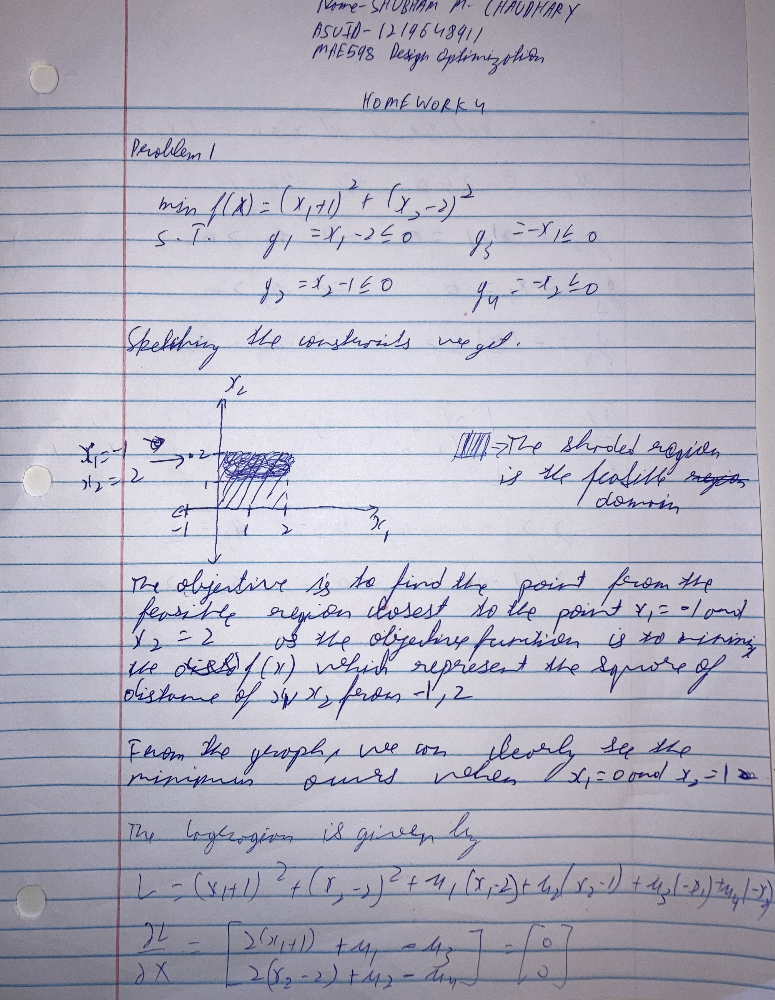

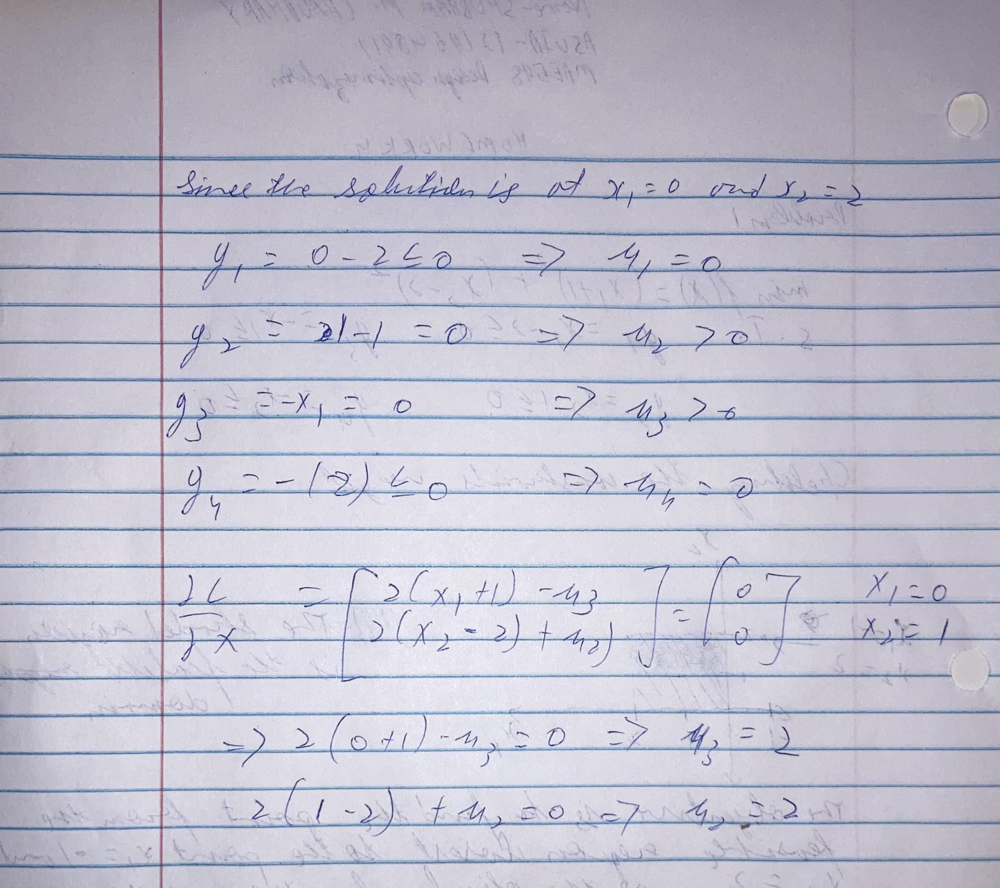

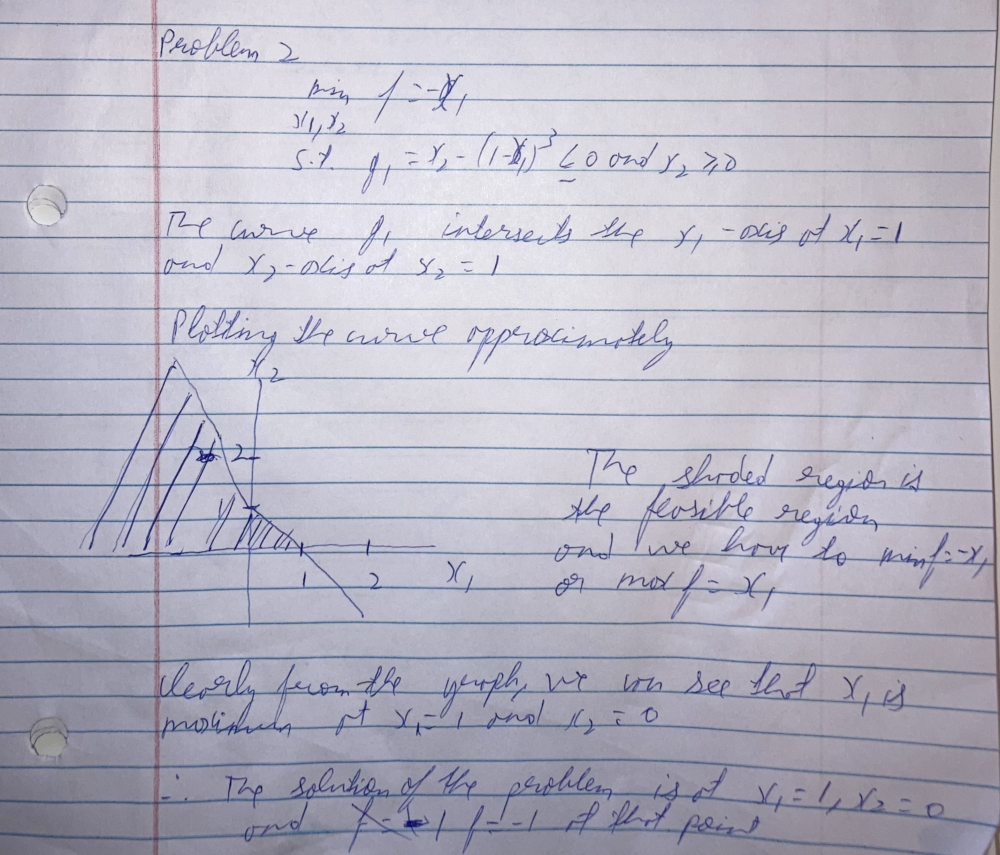

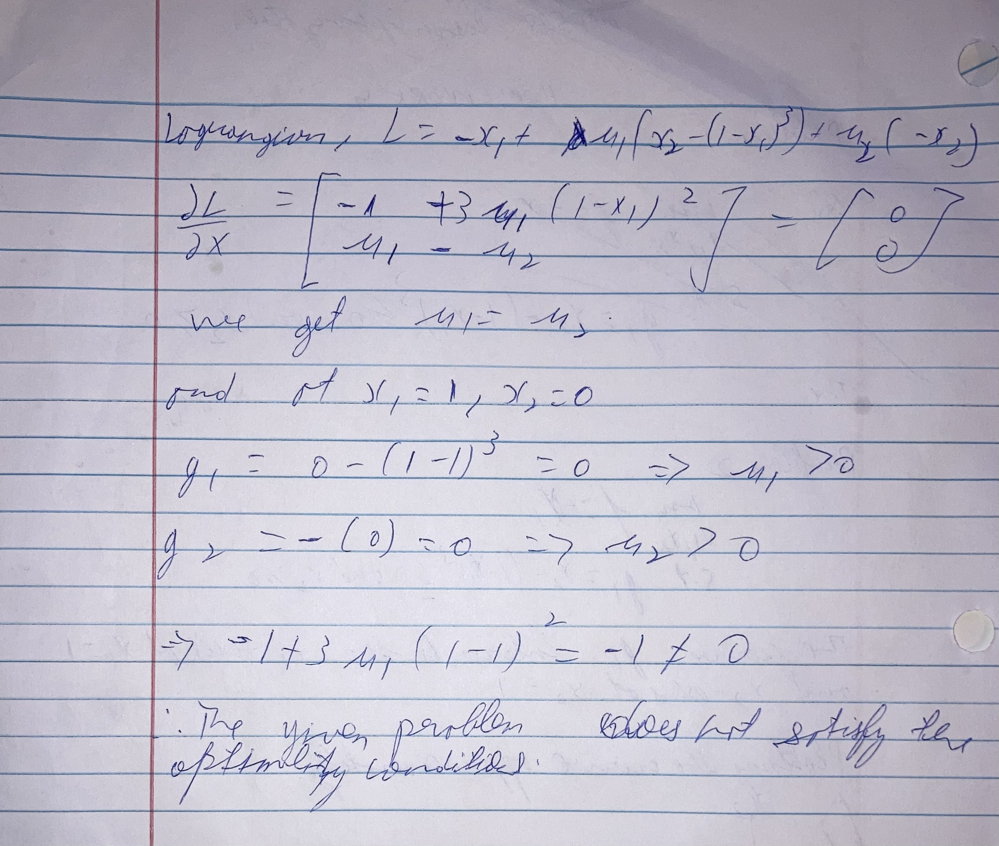

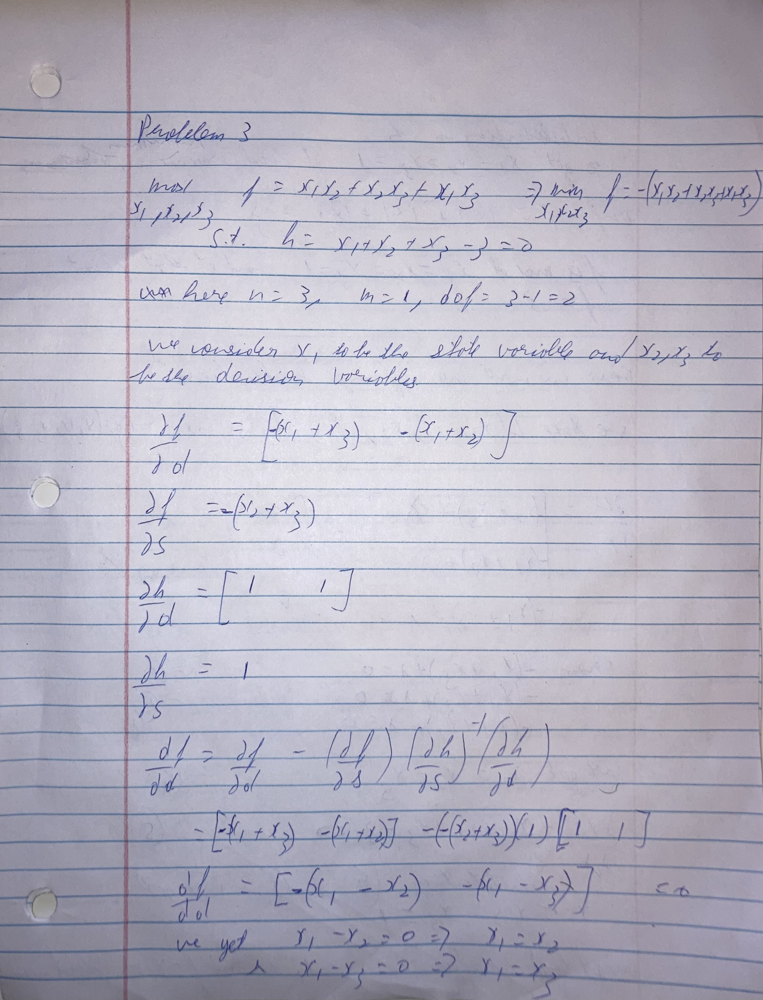

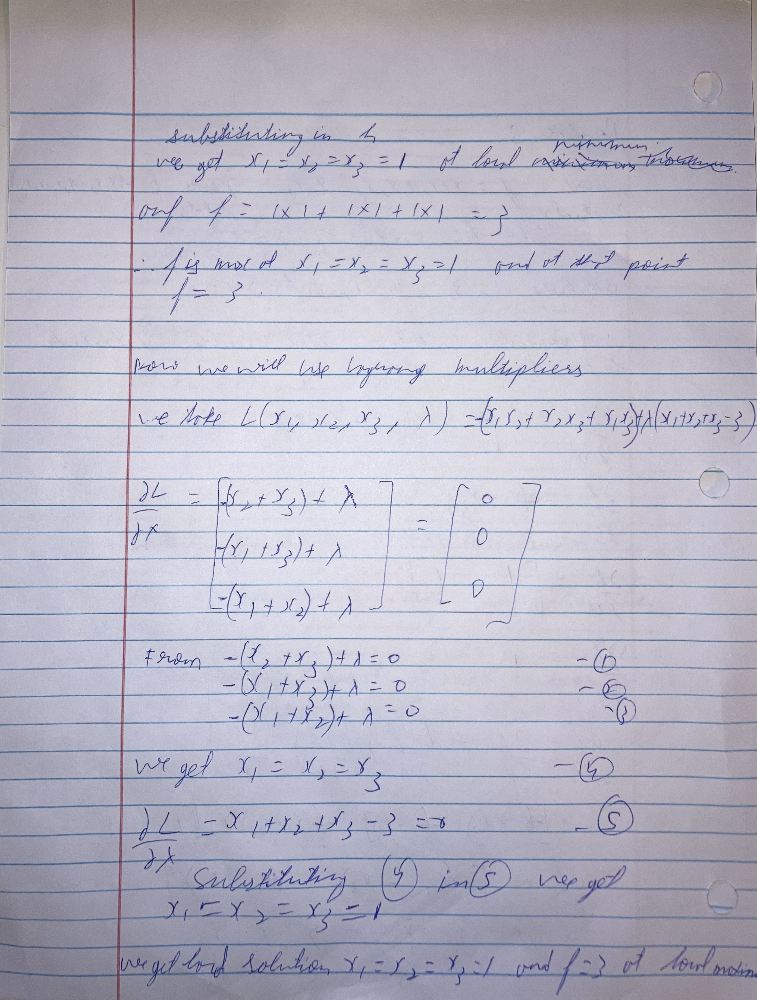

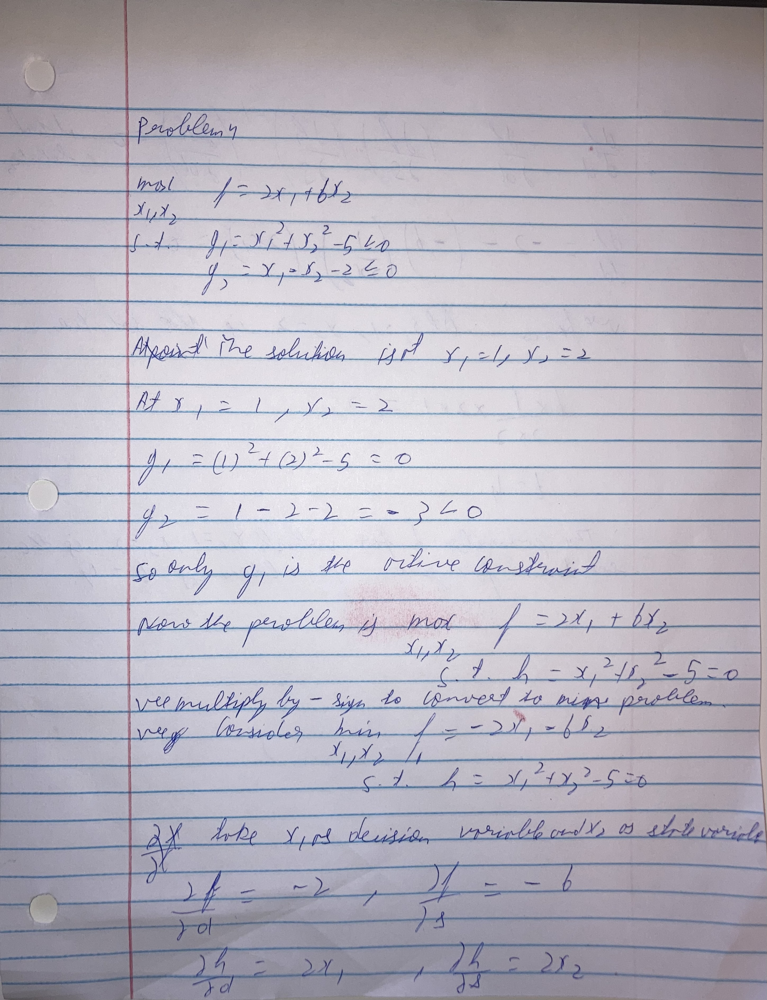

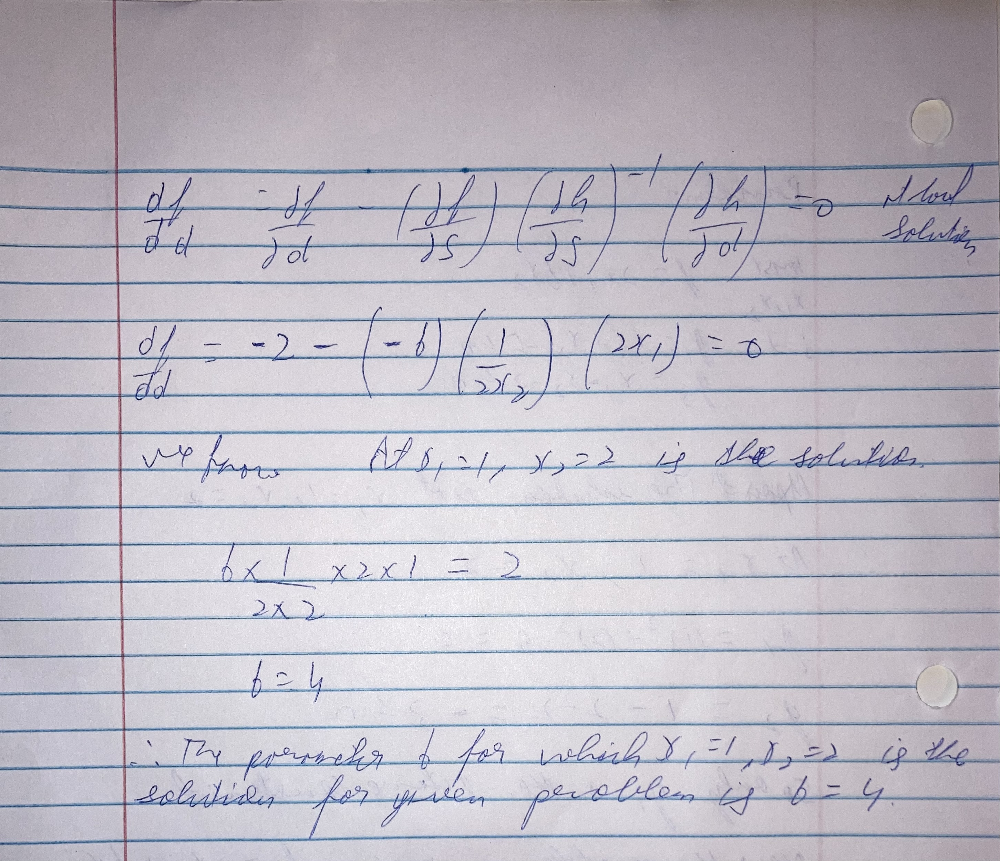

In [4]:
##Problem 5
import numpy as np
import math
def objfn(d,s):
    return d*d + s[0]*s[0] + s[1]*s[1]  ##Defining the objective function
##Defining all the functions
def h(d,s):
    return np.array([(d*d)/4 + (s[0]*s[0])/5 + (s[1]*s[1])/25 - 1, d + s[0] - s[1]])
##Taking x1 as decision variable and x2,x3 as state variable
delfdeld = lambda d: 2*d
delfdels = lambda s: np.array([2*s[0], 2*s[1]])
delhdeld = lambda d: np.array([d/2, 1])
delhdels = lambda s: np.array([[2*s[0]/5, 2*s[1]/25], [1, -1]])

def dfdd(d,s):
    dfdd1 = np.matmul(delfdels(s),np.linalg.inv(delhdels(s)))
    dfdd2 = np.matmul(dfdd1, delhdeld(d))
    dfdd3 = delfdeld(d) - dfdd2
    return dfdd3


##line search to calculate alpha
def linesearch(d,s):
    a = 0.1     ##Alpha
    b = 0.5
    t = 0.3
    x = np.matmul(np.linalg.inv(delhdels(s)),delhdeld(d))*dfdd(d,s)
    s1 = s + a * np.transpose(x)
    d1 = d - a * dfdd(d,s)
    phi = objfn(d1,s1) + t*a*dfdd(d1,s1)*dfdd(d1,s1)
    while objfn(d1, s1) > phi:
        a = a*b
        x = np.matmul(np.linalg.inv(delhdels(s1)),delhdeld(d1))*dfdd(d1,s1)
        s1 = s + a * np.transpose(x)
        d1 = d - a * dfdd(d,s)
        phi = objn(d1, s1) - t*a*dfdd(d1,s1)*dfdd(d1,s1)
    return a
        
##solve function
def solve(d, s):
    h1 = h(d,s) + np.matmul(delhdels(s), s)
    s1 = np.transpose(s)
    while np.linalg.norm(h1) > 0.001:
        s1 = s1 - np.matmul(np.linalg.inv(delhdels(s)), h(d,s))
        s = np.transpose(s1)
        h1 = h(d,s)
    return s
    
count = 0 
#Set epsilion
e = 0.001    
##Initial guess    
d1 = 0
s1 = np.array([5/math.sqrt(6),5/math.sqrt(6)])
while np.linalg.norm(dfdd(d1,s1)) >= e:
    alpha = linesearch(d1,s1)
    d1 = d1 - alpha*dfdd(d1,s1)
    x = np.matmul(np.linalg.inv(delhdels(s1)),delhdeld(d1))*dfdd(d1,s1)
    s1 = s1 + alpha * np.transpose(x)
    s1 = solve(d1,s1)
    count = count + 1
print('The Solution is x1 = ',d1,', x2 = ',s1[0],', x3 = ',s1[1],' and at that point f = ', objfn(d1,s1))


The Solution is x1 =  -1.5738594718660956 , x2 =  1.3769357897838963 , x3 =  -0.19692368208219932  and at that point f =  4.411764742935239
